In [1]:
import cv2 
import argparse

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import torch
from torch.utils.data import DataLoader

import datasets
import util.misc as utils
from models import build_model
import datasets.transforms as T

In [2]:
def get_args_parser():
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--lr_backbone', default=1.00e-5, type=float)
    parser.add_argument('--batch_size', default=1, type=int, choices=[1])

    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")
    parser.add_argument('--resume', default='/home/marufm/intr-projects/INTR/checkpoints/intr_checkpoint_cub_detr_r50.pth',
                        help='resume from checkpoint')
    
    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer") #default=0.1
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=200, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    # # * Dataset parameters
    parser.add_argument('--dataset_name', default='cub') 

    # * Device parameters
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    
    return parser

In [3]:
def get_args_parser_new_model():
    parser = argparse.ArgumentParser('Set transformer detector', add_help=False)
    parser.add_argument('--lr_backbone', default=1.00e-5, type=float)
    parser.add_argument('--batch_size', default=1, type=int, choices=[1])

    # * Backbone
    parser.add_argument('--backbone', default='resnet50', type=str,
                        help="Name of the convolutional backbone to use")
    parser.add_argument('--dilation', action='store_true',
                        help="If true, we replace stride with dilation in the last convolutional block (DC5)")
    parser.add_argument('--position_embedding', default='sine', type=str, choices=('sine', 'learned'),
                        help="Type of positional embedding to use on top of the image features")
    parser.add_argument('--resume', default='/home/marufm/intr-projects/INTR/output/intr_trained/cub_checkpoint.pth',
                        help='resume from checkpoint')
    
    # * Transformer
    parser.add_argument('--enc_layers', default=6, type=int,
                        help="Number of encoding layers in the transformer")
    parser.add_argument('--dec_layers', default=6, type=int,
                        help="Number of decoding layers in the transformer")
    parser.add_argument('--dim_feedforward', default=2048, type=int,
                        help="Intermediate size of the feedforward layers in the transformer blocks")
    parser.add_argument('--hidden_dim', default=256, type=int,
                        help="Size of the embeddings (dimension of the transformer)")
    parser.add_argument('--dropout', default=0.1, type=float,
                        help="Dropout applied in the transformer") #default=0.1
    parser.add_argument('--nheads', default=8, type=int,
                        help="Number of attention heads inside the transformer's attentions")
    parser.add_argument('--num_queries', default=200, type=int,
                        help="Number of query slots")
    parser.add_argument('--pre_norm', action='store_true')

    # # * Dataset parameters
    parser.add_argument('--dataset_name', default='cub') 

    # * Device parameters
    parser.add_argument('--device', default='cuda',
                        help='device to use for training / testing')
    
    return parser

In [4]:
data_mean_std = {
    "cub": (
        torch.tensor([0.485, 0.456, 0.406]),
        torch.tensor([0.229, 0.224, 0.225]),
    ),
}

class SingleImageDataset:
    def __init__(self, image_path, transform=None):
        self.image_path = image_path
        self.transform = transform

    def __getitem__(self, index):
        img = Image.open(self.image_path).convert('RGB')

        target = {}
        target["file_name"] = [str(self.image_path)]
        target["image_label"] = torch.tensor([0000], dtype=torch.int64)  # Set the target label as needed

        if self.transform is not None:
            img, target = self.transform(img, target)

        return img, target

    def __len__(self):
        return 1  

def make_transforms():
    mean, std = data_mean_std["cub"]

    normalize = T.Compose([
        T.ToTensor(),
        T.Normalize(mean, std)
    ])
    return T.Compose([
        T.RandomResize([800], max_size=1333),
        normalize,
    ])

def build_single_image_dataset(image_path):
    transform = make_transforms()
    dataset = SingleImageDataset(image_path=image_path, transform=transform)
    return dataset

def image_preprocessing(image_path):
    single_image_dataset = build_single_image_dataset(image_path)
    sampler_val = torch.utils.data.SequentialSampler(single_image_dataset)
    data_loader_val = DataLoader(single_image_dataset, args.batch_size, sampler=sampler_val,
                                 drop_last=False, collate_fn=utils.collate_fn, num_workers=1) 
    return data_loader_val

In [5]:
def load_model(args, model):
    checkpoint = torch.load(args.resume, map_location='cpu')
    model.load_state_dict(checkpoint['model'])
    return model

In [6]:
@torch.no_grad()
def predicted_class(output, topk=(1,)):
    query_logits = output['query_logits']
    batch_size = query_logits.size(0)
    
    maxk = min(max(topk), query_logits.size(1))
    _, pred = query_logits.topk(maxk, dim=1, largest=True, sorted=True)
    return pred

In [7]:
def get_class_name(number, filename="demo_image/classes.txt"):
    with open(filename, "r") as file:
        lines = file.readlines()
    for line in lines:
        parts = line.strip().split(" ", 1)
        if parts[0] == str(number):
            class_name = parts[1]
            break
    else:
        return f"No class found for number {number}"

    class_name_parts = class_name.split(".")
    modified_name = " ".join(part.capitalize() for part in class_name_parts[1].split("_"))

    return modified_name

def get_new_class_name(number, filename="demo_image/new_classes.txt"):
    with open(filename, "r") as file:
        lines = file.readlines()
    for line in lines:
        parts = line.strip().split(" ", 1)
        if parts[0] == str(number):
            class_name = parts[1]
            break
    else:
        return f"No class found for number {number}"

    return " ".join(class_name.split("_")[-2:])
    # class_name_parts = class_name.split(".")
    # modified_name = " ".join(part.capitalize() for part in class_name_parts[1].split("_"))

    # return modified_name

In [8]:
def SuperImposeHeatmap(attention, input_image):
    alpha=0.5
    avg_heatmap_resized = cv2.resize(attention, (input_image.shape[1], input_image.shape[0]), interpolation=cv2.INTER_CUBIC)
    avg_normalized_heatmap = (avg_heatmap_resized - np.min(avg_heatmap_resized)) / (np.max(avg_heatmap_resized) - np.min(avg_heatmap_resized))
    heatmap = (avg_normalized_heatmap * 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.medianBlur(heatmap,15)
    heatmap =  cv2.GaussianBlur(heatmap, (15, 15), 0)
    result = (input_image *alpha  + heatmap * (1-alpha)).astype(np.uint8)
    return result

In [9]:
def visualization(args, image_path, query_index, attention_scores, encoder_output):

    attention_score = attention_scores[5, :, :, :, :] # sixth layer of the decoder
    attention_score_pred_query = attention_score[:, :, query_index, :] # query corresponding to predicted class 

    # Load and resize the original image
    input_image = cv2.imread(image_path)
    input_image = cv2.resize(input_image, (0, 0), fx=0.8, fy=0.8)

    # Create a subplot grid for the original image and visualizations
    num_heads = attention_score_pred_query.shape[1] + 1  
    rows = 1
    cols = num_heads // rows

    # Plot the original image
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 5, rows * 5))
    axes[0].imshow(cv2.cvtColor(input_image, cv2.COLOR_BGR2RGB))
    axes[0].axis('off')

    for head_index in range(attention_score_pred_query.shape[1]):
        heatmap_head = attention_score_pred_query[:, head_index, :].reshape(encoder_output.shape[2], encoder_output.shape[3]).detach().cpu().numpy()
        result = SuperImposeHeatmap(heatmap_head, input_image)

        if rows == 1 and cols == 1:
            ax = axes
        elif rows == 1:
            ax = axes[head_index + 1]
        elif cols == 1:
            ax = axes[head_index + 1]
        else:
            ax = axes[(head_index + 1) // cols, (head_index + 1) % cols]

        ax.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        ax.axis('off')

    plt.tight_layout()
    plt.show()

/home/ksmehrab/miniconda/envs/data_env/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/ksmehrab/miniconda/envs/data_env/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
/home/ksmehrab/miniconda/envs/data_env/lib/python3.9/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at /opt/conda/conda-bld/pytorch_1712608883

Species predicted by INTR is: Painted Bunting 



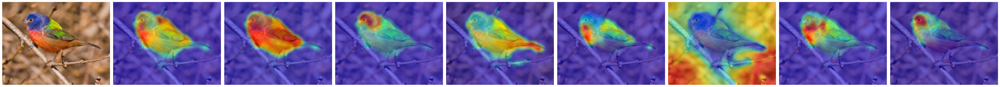

Test:  [0/1]  eta: 0:00:03    time: 3.2067  data: 0.4621  max mem: 920
Test: Total time: 0:00:03 (3.2988 s / it)


In [10]:
def main(args):
    
    image_path = "demo_image/Painted_Bunting_0004_16641.jpg"
    
    test_image_loader=image_preprocessing(image_path)

    device = torch.device(args.device)
    model, _ = build_model(args)
    model.to(device)
    model=load_model(args, model)
    model.eval()

    metric_logger = utils.MetricLogger(delimiter="  ")
    header = 'Test:'
    for samples, targets in metric_logger.log_every(test_image_loader, 1, header):
        samples = samples.to(device)
    
        outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
        pred_class_index=predicted_class(outputs, topk=(1, 1))
        print ("Species predicted by INTR is:",get_class_name(int(pred_class_index[0][0])+1), "\n")

        visualization(args, image_path, int(pred_class_index[0][0]), attention_scores, encoder_output)

if __name__ == '__main__':
    parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[get_args_parser()])
    args = parser.parse_args(args=[])
    main(args)

Species predicted by INTR is: Painted Bunting 



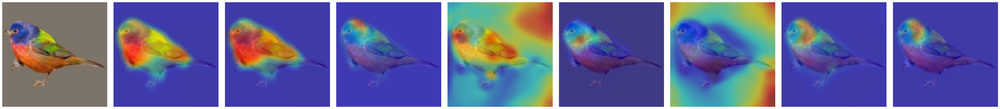

Test:  [0/1]  eta: 0:00:00    time: 0.9912  data: 0.3548  max mem: 921
Test: Total time: 0:00:01 (1.0250 s / it)


In [10]:
# image_path = "/home/marufm/intr-projects/INTR/datasets/cub/val/cub_016_Painted_Bunting/Painted_Bunting_0004_16641.jpg"
def main(args):
    
    image_path = "/home/marufm/intr-projects/INTR/datasets/cub/val/cub_016_Painted_Bunting/Painted_Bunting_0004_16641.jpg"
    
    test_image_loader=image_preprocessing(image_path)

    device = torch.device(args.device)
    model, _ = build_model(args)
    model.to(device)
    model=load_model(args, model)
    model.eval()

    metric_logger = utils.MetricLogger(delimiter="  ")
    header = 'Test:'
    for samples, targets in metric_logger.log_every(test_image_loader, 1, header):
        samples = samples.to(device)
    
        outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
        pred_class_index=predicted_class(outputs, topk=(1, 1))
        print ("Species predicted by INTR is:",get_class_name(int(pred_class_index[0][0])+1), "\n")

        visualization(args, image_path, int(pred_class_index[0][0]), attention_scores, encoder_output)

if __name__ == '__main__':
    parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[get_args_parser()])
    args = parser.parse_args(args=[])
    main(args)

In [48]:
import os 
demo_dir = '/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/'
demo_images = os.listdir(demo_dir)
demo_images = [name for name in demo_images if name[-4:]=='.jpg']
demo_images

['Western_Grebe_0102_36116.jpg',
 'Western_Grebe_0090_36182.jpg',
 'Western_Grebe_0087_36570.jpg',
 'Western_Grebe_0033_36395.jpg',
 'Western_Grebe_0051_36249.jpg',
 'Western_Grebe_0091_36194.jpg',
 'Western_Grebe_0089_36154.jpg',
 'Western_Grebe_0036_36521.jpg',
 'Western_Grebe_0064_36613.jpg',
 'Western_Grebe_0002_36518.jpg',
 'Western_Grebe_0083_36033.jpg',
 'Western_Grebe_0048_36399.jpg',
 'Western_Grebe_0106_36509.jpg',
 'Western_Grebe_0049_36219.jpg',
 'Western_Grebe_0105_36542.jpg',
 'Western_Grebe_0020_36241.jpg',
 'Western_Grebe_0103_36515.jpg',
 'Western_Grebe_0044_36188.jpg',
 'Western_Grebe_0071_36536.jpg',
 'Western_Grebe_0013_36383.jpg',
 'Western_Grebe_0009_36477.jpg',
 'Western_Grebe_0021_36282.jpg',
 'Western_Grebe_0042_36035.jpg',
 'Western_Grebe_0038_36363.jpg',
 'Western_Grebe_0043_36183.jpg',
 'Western_Grebe_0081_36578.jpg',
 'Western_Grebe_0104_36164.jpg',
 'Western_Grebe_0029_36379.jpg',
 'Western_Grebe_0011_36522.jpg',
 'Western_Grebe_0077_36355.jpg']

In [49]:
# demo_images = ['Painted_Bunting_0004_16641.jpg', 'Painted_Bunting_0008_16416.jpg', 'Painted_Bunting_0009_16674.jpg', 'Painted_Bunting_0010_16948.jpg', 'Painted_Bunting_0011_16690.jpg', 'Painted_Bunting_0013_15294.jpg', 'Painted_Bunting_0016_15200.jpg', 'Painted_Bunting_0019_15231.jpg', 'Painted_Bunting_0021_15295.jpg', 'Painted_Bunting_0027_16536.jpg', 'Painted_Bunting_0029_16530.jpg', 'Painted_Bunting_0032_16605.jpg', 'Painted_Bunting_0040_16691.jpg', 'Painted_Bunting_0044_16557.jpg', 'Painted_Bunting_0049_16869.jpg', 'Painted_Bunting_0053_16404.jpg', 'Painted_Bunting_0054_16711.jpg', 'Painted_Bunting_0058_16719.jpg', 'Painted_Bunting_0069_16462.jpg', 'Painted_Bunting_0072_16697.jpg', 'Painted_Bunting_0077_16819.jpg', 'Painted_Bunting_0078_16565.jpg', 'Painted_Bunting_0080_16534.jpg', 'Painted_Bunting_0081_15230.jpg', 'Painted_Bunting_0085_15282.jpg', 'Painted_Bunting_0094_16467.jpg', 'Painted_Bunting_0098_15226.jpg', 'Painted_Bunting_0102_16642.jpg']
import os
parser = argparse.ArgumentParser('INTR interpretation visualization script', parents=[get_args_parser_new_model()])
args = parser.parse_args(args=[])

/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0102_36116.jpg
Species predicted by INTR is: Western Grebe 



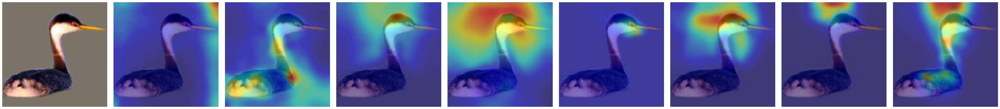

Test:  [0/1]  eta: 0:00:01    time: 1.0337  data: 0.4477  max mem: 1493
Test: Total time: 0:00:01 (1.0713 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0090_36182.jpg
Species predicted by INTR is: Horned Grebe 



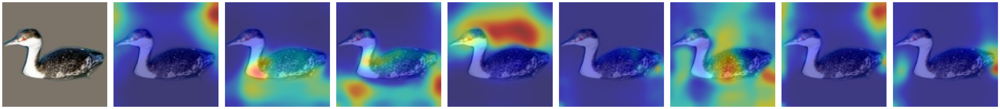

Test:  [0/1]  eta: 0:00:01    time: 1.0411  data: 0.4365  max mem: 1493
Test: Total time: 0:00:01 (1.0815 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0087_36570.jpg
Species predicted by INTR is: Western Grebe 



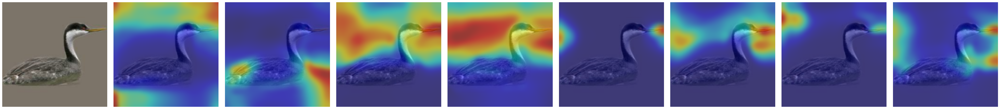

Test:  [0/1]  eta: 0:00:01    time: 1.0519  data: 0.4198  max mem: 1493
Test: Total time: 0:00:01 (1.1080 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0033_36395.jpg
Species predicted by INTR is: Western Grebe 



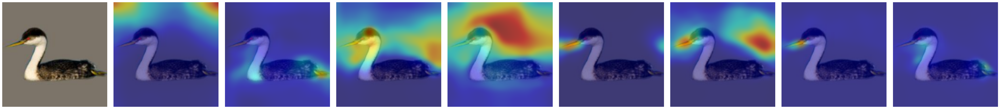

Test:  [0/1]  eta: 0:00:01    time: 1.1175  data: 0.4345  max mem: 1493
Test: Total time: 0:00:01 (1.1588 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0051_36249.jpg
Species predicted by INTR is: Western Grebe 



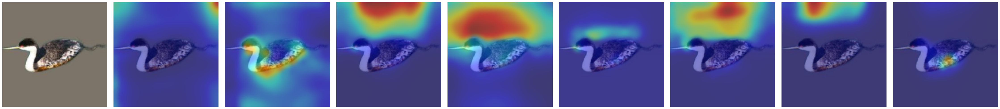

Test:  [0/1]  eta: 0:00:00    time: 0.9705  data: 0.4417  max mem: 1493
Test: Total time: 0:00:01 (1.0078 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0091_36194.jpg
Species predicted by INTR is: Western Grebe 



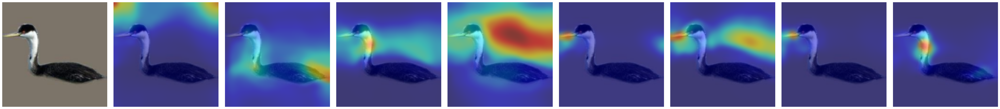

Test:  [0/1]  eta: 0:00:00    time: 0.9755  data: 0.4570  max mem: 1493
Test: Total time: 0:00:01 (1.0133 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0089_36154.jpg
Species predicted by INTR is: Rhinoceros Auklet 



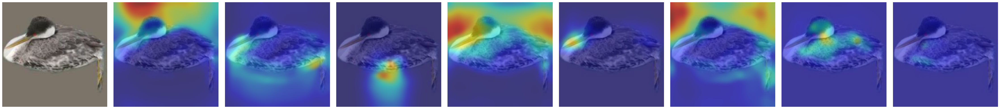

Test:  [0/1]  eta: 0:00:01    time: 1.0524  data: 0.4332  max mem: 1493
Test: Total time: 0:00:01 (1.0892 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0036_36521.jpg
Species predicted by INTR is: Western Grebe 



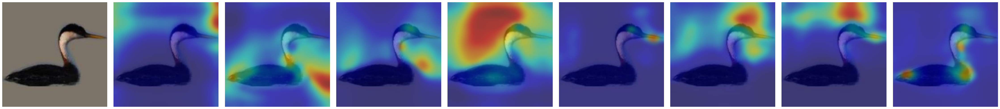

Test:  [0/1]  eta: 0:00:01    time: 1.1512  data: 0.4354  max mem: 1493
Test: Total time: 0:00:01 (1.1911 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0064_36613.jpg
Species predicted by INTR is: Western Grebe 



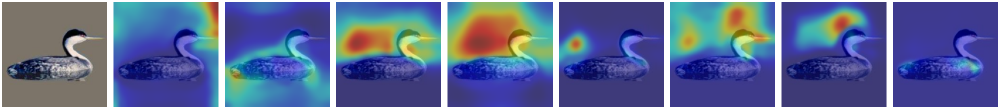

Test:  [0/1]  eta: 0:00:01    time: 1.0046  data: 0.4242  max mem: 1493
Test: Total time: 0:00:01 (1.0424 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0002_36518.jpg
Species predicted by INTR is: Western Grebe 



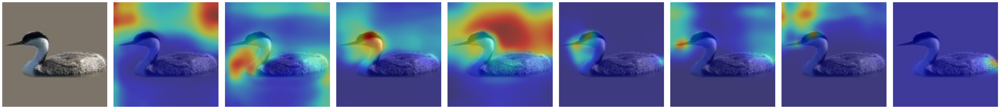

Test:  [0/1]  eta: 0:00:00    time: 0.9929  data: 0.4378  max mem: 1493
Test: Total time: 0:00:01 (1.0311 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0083_36033.jpg
Species predicted by INTR is: Eared Grebe 



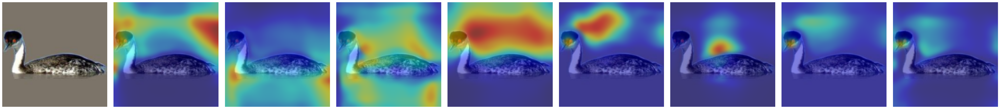

Test:  [0/1]  eta: 0:00:00    time: 0.9982  data: 0.4068  max mem: 1493
Test: Total time: 0:00:01 (1.0378 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0048_36399.jpg
Species predicted by INTR is: Loggerhead Shrike 



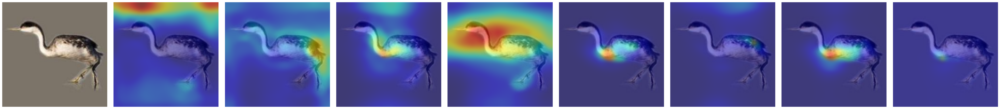

Test:  [0/1]  eta: 0:00:01    time: 1.1083  data: 0.4312  max mem: 1493
Test: Total time: 0:00:01 (1.1499 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0106_36509.jpg
Species predicted by INTR is: Western Grebe 



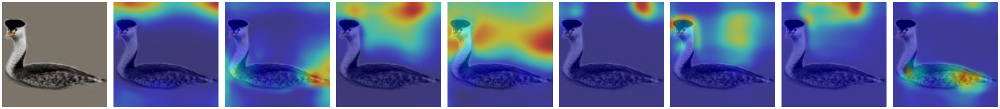

Test:  [0/1]  eta: 0:00:00    time: 0.9993  data: 0.4211  max mem: 1493
Test: Total time: 0:00:01 (1.0369 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0049_36219.jpg
Species predicted by INTR is: Western Grebe 



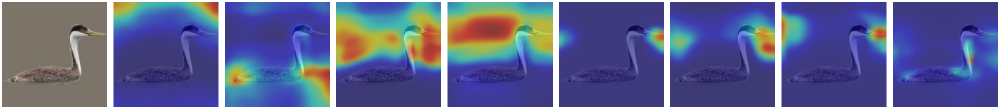

Test:  [0/1]  eta: 0:00:00    time: 0.9636  data: 0.4304  max mem: 1493
Test: Total time: 0:00:01 (1.0003 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0105_36542.jpg
Species predicted by INTR is: Western Grebe 



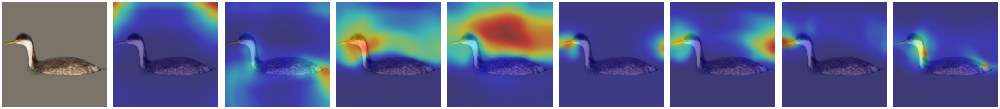

Test:  [0/1]  eta: 0:00:00    time: 0.9561  data: 0.4166  max mem: 1493
Test: Total time: 0:00:00 (0.9944 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0020_36241.jpg
Species predicted by INTR is: Western Grebe 



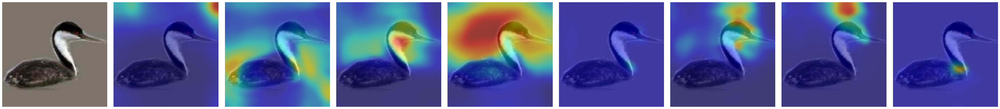

Test:  [0/1]  eta: 0:00:01    time: 1.1260  data: 0.4359  max mem: 1493
Test: Total time: 0:00:01 (1.1659 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0103_36515.jpg
Species predicted by INTR is: tailed Jaeger 



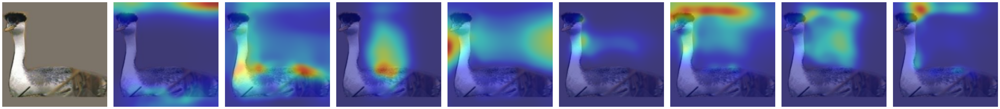

Test:  [0/1]  eta: 0:00:00    time: 0.9980  data: 0.3959  max mem: 1493
Test: Total time: 0:00:01 (1.0345 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0044_36188.jpg
Species predicted by INTR is: Western Grebe 



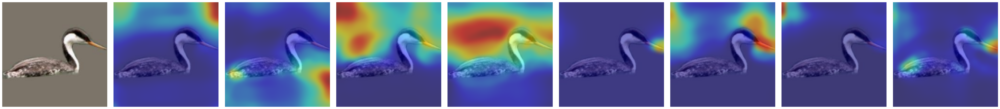

Test:  [0/1]  eta: 0:00:01    time: 1.0025  data: 0.4588  max mem: 1493
Test: Total time: 0:00:01 (1.0401 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0071_36536.jpg
Species predicted by INTR is: Western Grebe 



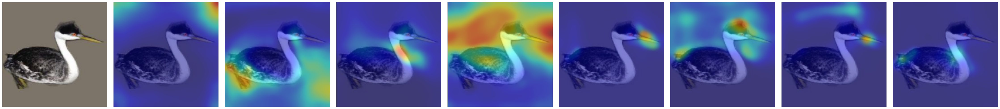

Test:  [0/1]  eta: 0:00:01    time: 1.0150  data: 0.4420  max mem: 1496
Test: Total time: 0:00:01 (1.0548 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0013_36383.jpg
Species predicted by INTR is: Western Grebe 



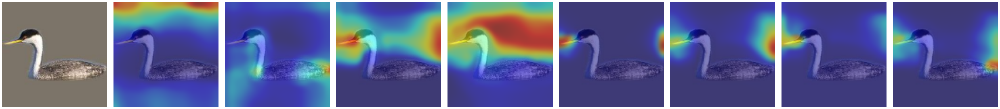

Test:  [0/1]  eta: 0:00:01    time: 1.0669  data: 0.4015  max mem: 1496
Test: Total time: 0:00:01 (1.1077 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0009_36477.jpg
Species predicted by INTR is: Western Grebe 



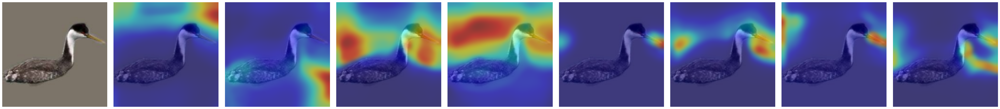

Test:  [0/1]  eta: 0:00:00    time: 0.9715  data: 0.4201  max mem: 1496
Test: Total time: 0:00:01 (1.0087 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0021_36282.jpg
Species predicted by INTR is: Western Grebe 



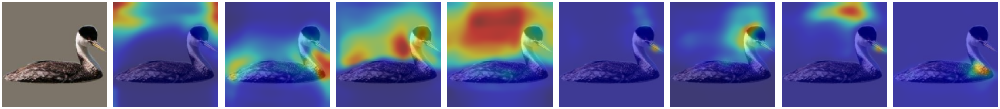

Test:  [0/1]  eta: 0:00:01    time: 1.0757  data: 0.4638  max mem: 1496
Test: Total time: 0:00:01 (1.1284 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0042_36035.jpg
Species predicted by INTR is: Western Grebe 



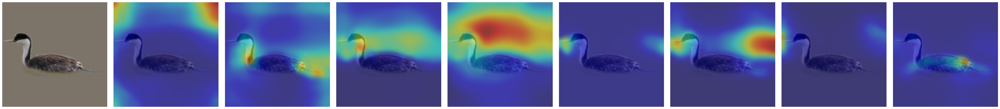

Test:  [0/1]  eta: 0:00:00    time: 0.8977  data: 0.3741  max mem: 1496
Test: Total time: 0:00:00 (0.9341 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0038_36363.jpg
Species predicted by INTR is: Western Grebe 



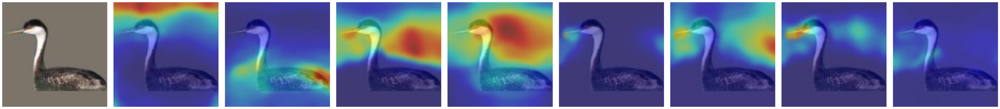

Test:  [0/1]  eta: 0:00:01    time: 1.0132  data: 0.4509  max mem: 1496
Test: Total time: 0:00:01 (1.0508 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0043_36183.jpg
Species predicted by INTR is: Western Grebe 



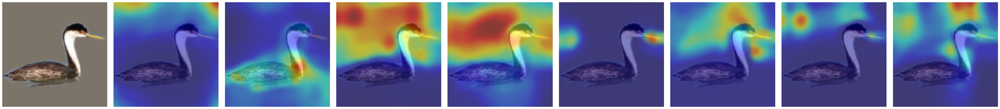

Test:  [0/1]  eta: 0:00:01    time: 1.0484  data: 0.4402  max mem: 1497
Test: Total time: 0:00:01 (1.0884 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0081_36578.jpg
Species predicted by INTR is: Western Grebe 



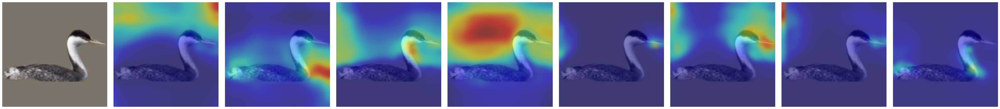

Test:  [0/1]  eta: 0:00:00    time: 0.9992  data: 0.4617  max mem: 1497
Test: Total time: 0:00:01 (1.0377 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0104_36164.jpg
Species predicted by INTR is: Western Grebe 



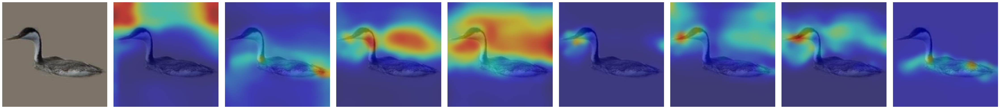

Test:  [0/1]  eta: 0:00:00    time: 0.9802  data: 0.4439  max mem: 1497
Test: Total time: 0:00:01 (1.0202 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0029_36379.jpg
Species predicted by INTR is: Western Grebe 



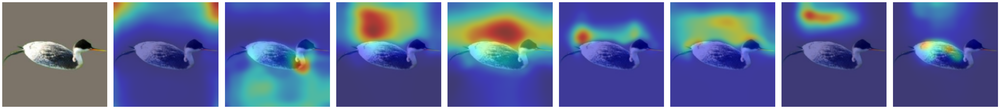

Test:  [0/1]  eta: 0:00:00    time: 0.9747  data: 0.4429  max mem: 1497
Test: Total time: 0:00:01 (1.0122 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0011_36522.jpg
Species predicted by INTR is: Western Grebe 



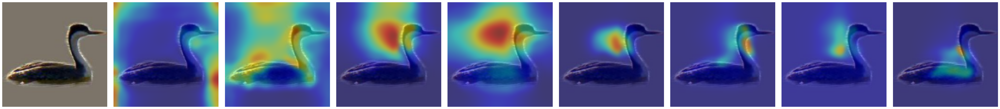

Test:  [0/1]  eta: 0:00:01    time: 1.1212  data: 0.4066  max mem: 1497
Test: Total time: 0:00:01 (1.1628 s / it)
/home/marufm/intr-projects/INTR/datasets/cub/val/cub_053_Western_Grebe/Western_Grebe_0077_36355.jpg
Species predicted by INTR is: Western Grebe 



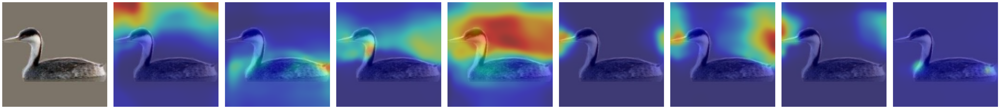

Test:  [0/1]  eta: 0:00:00    time: 0.9468  data: 0.4004  max mem: 1497
Test: Total time: 0:00:00 (0.9845 s / it)


In [52]:
for img in demo_images:
    
    image_path = os.path.join(demo_dir, img)
    print(image_path)

    device = torch.device(args.device)
    
    test_image_loader=image_preprocessing(image_path)
    
    model, _ = build_model(args)
    model.to(device)
    model=load_model(args, model)
    model.eval()

    metric_logger = utils.MetricLogger(delimiter="  ")
    header = 'Test:'
    for samples, targets in metric_logger.log_every(test_image_loader, 1, header):
        samples = samples.to(device)
    
        outputs, encoder_output, _, attention_scores, avg_attention_scores = model(samples)
        pred_class_index=predicted_class(outputs, topk=(1, 1))

        print ("Species predicted by INTR is:",get_new_class_name(int(pred_class_index[0][0])+1), "\n")

        visualization(args, image_path, int(pred_class_index[0][0]), attention_scores, encoder_output)
